<a href="https://colab.research.google.com/github/HAYAM-ABDELBASET/Diff-JPEG/blob/main/Differentiable_JPEG_The_Devil_is_in_the_Details.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!git clone https://github.com/necla-ml/diff-jpeg.git

Cloning into 'diff-jpeg'...
remote: Enumerating objects: 88, done.
remote: Counting objects: 100% (88/88), done.
remote: Compressing objects: 100% (84/84), done.
remote: Total 88 (delta 43), reused 18 (delta 2), pack-reused 0
Receiving objects: 100% (88/88), 24.60 MiB | 39.68 MiB/s, done.
Resolving deltas: 100% (43/43), done.


In [2]:
%cd diff-jpeg
!pip install -r requirements.txt


/content/diff-jpeg
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 756.0/756.0 kB 12.4 MB/s eta 0:00:00


In [16]:
%cd /content/diff-jpeg/
!python setup.py



/content/diff-jpeg
usage: setup.py [global_opts] cmd1 [cmd1_opts] [cmd2 [cmd2_opts] ...]
   or: setup.py --help [cmd1 cmd2 ...]
   or: setup.py --help-commands
   or: setup.py cmd --help

error: no commands supplied


In [15]:
%cd /content/diff-jpeg/
!ls


/content/diff-jpeg
CITATION.cff  example.py  LICENSE	 output_image.jpeg  README.md	      setup.py
diff_jpeg     github	  non_diff_jpeg  PATENTS	    requirements.txt  test_images


In [17]:
%cd /content/diff-jpeg/
!python example.py


/content/diff-jpeg
/usr/local/lib/python3.10/dist-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3526.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
0.4044535160064697


In [19]:
import torch
import torchvision
from torch import Tensor
import warnings
from diff_jpeg import diff_jpeg_coding

# Load test image and reshape to [B, 3, H, W]
image: Tensor = torchvision.io.read_image("test_images/test_image.png").float()[None]
# Init JPEG quality
jpeg_quality: Tensor = torch.tensor([2.0])
# Perform differentiable JPEG coding
image_coded: Tensor = diff_jpeg_coding(image_rgb=image, jpeg_quality=jpeg_quality)
with warnings.catch_warnings():
    warnings.simplefilter("ignore")

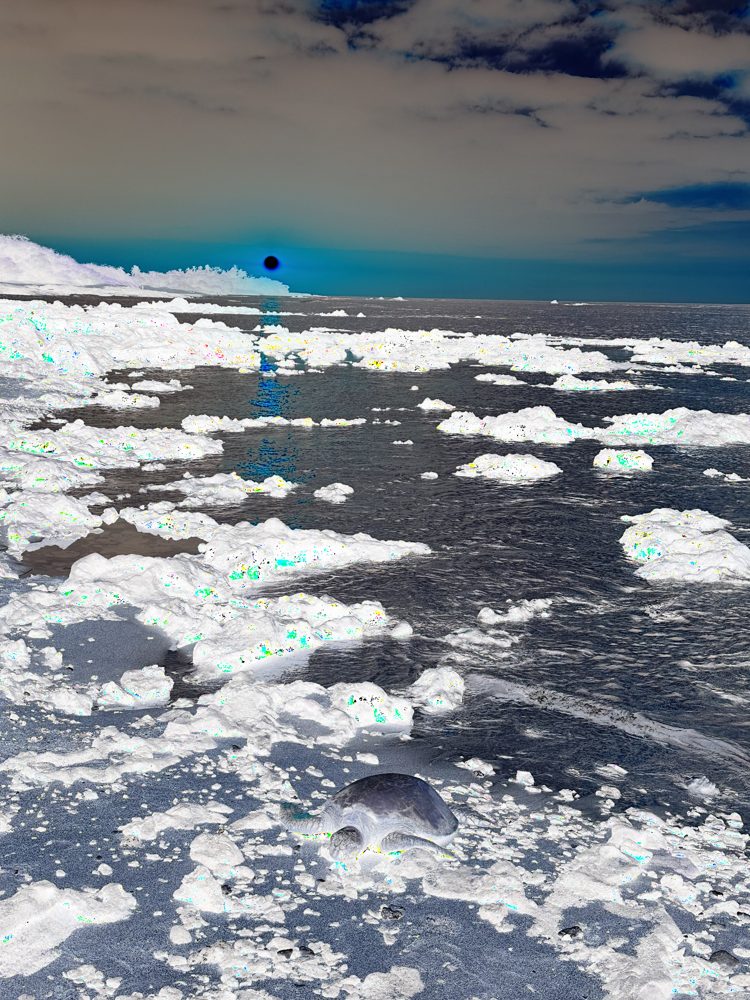

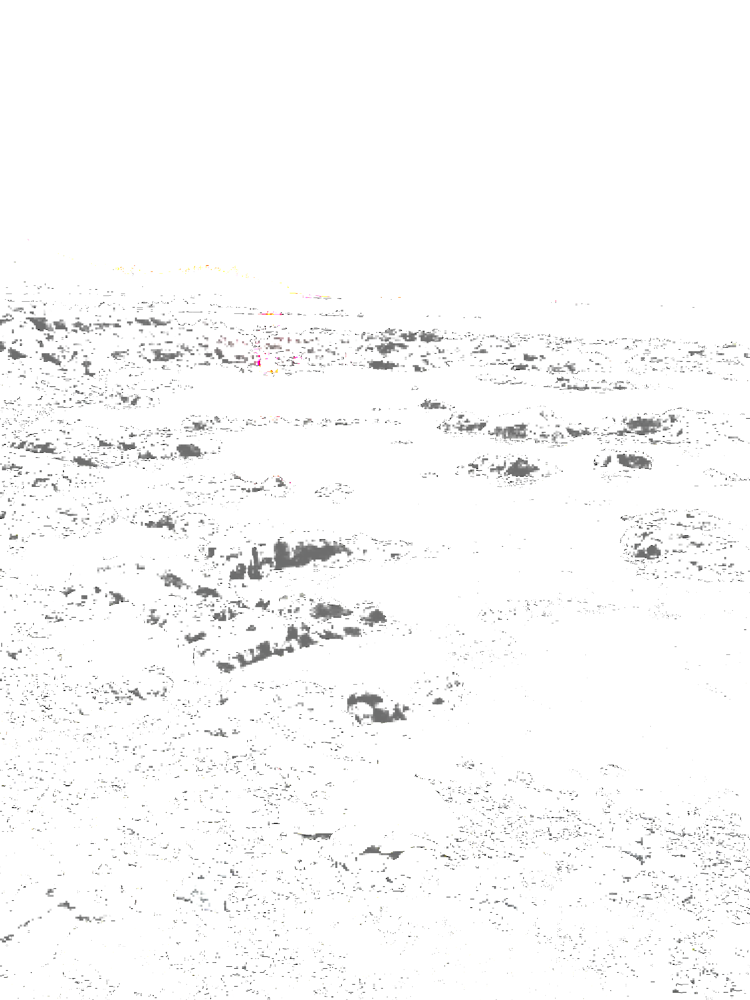

In [31]:
import torch
import torchvision.transforms as transforms
from diff_jpeg import diff_jpeg_coding

# Load test image and reshape to [B, 3, H, W]
image = torchvision.io.read_image("test_images/test_image.png").float()[None]

# Init JPEG quality
jpeg_quality = torch.tensor([2.0])
image_pil = transforms.ToPILImage()(image[0])
# Perform differentiable JPEG coding
image_coded = diff_jpeg_coding(image_rgb=image, jpeg_quality=jpeg_quality)

# Save the coded image using torchvision
#torchvision.io.write_jpeg(image_coded[0].squeeze(0), "image_coded.jpg")
coded_image_pil = transforms.ToPILImage()(image_coded[0].clamp(0, 1))

# Save the PIL Image
coded_image_pil.save("coded_image.jpg")
image_pil.save("original_image.png")
coded_image_pil.save("coded_image.png")

# Display the original and coded images using IPython's Image display
display(Image(filename="original_image.png", width=300), Image(filename="coded_image.png", width=300))

